In [ ]:
!pip install -q ultralytics imutils

In [46]:
from tqdm.auto import tqdm

import os
import requests
import zipfile
import cv2
import math
import matplotlib.pyplot as plt
import glob
import numpy as np
import random

from PIL import Image

# Visualize dataset

In [2]:
ROOT_DIR = '/kaggle/input/hituav-a-highaltitude-infrared-thermal-dataset/hit-uav'
train_imgs_dir = 'images/train'
train_labels_dir = 'labels/train'
val_imgs_dir = 'images/val'
val_labels_dir = 'labels/val'
test_imgs_dir = 'images/test'
test_labels_dir = 'labels/test'
classes = ['Person', 'Car', 'Bicycle', 'OtherVechicle', 'DontCare']
colors = np.random.uniform(0, 255, size=(len(classes), 3))

In [3]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [32]:
def plot_box(image, bboxes, labels, classes=classes, colors=colors, pos='above'):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    height, width, _ = image.shape
    lw = max(round(sum(image.shape) / 2 * 0.003), 2)  # Line width.
    tf = max(lw - 1, 1) # Font thickness.
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*width)
        ymin = int(y1*height)
        xmax = int(x2*width)
        ymax = int(y2*height)

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        
        class_name = classes[int(labels[box_num])]

        color=colors[classes.index(class_name)]
        
        cv2.rectangle(
            image, 
            p1, p2,
            color=color, 
            thickness=lw,
            lineType=cv2.LINE_AA
        ) 

        # For filled rectangle.
        w, h = cv2.getTextSize(
            class_name, 
            0, 
            fontScale=lw / 3, 
            thickness=tf
        )[0]

        outside = p1[1] - h >= 3
        
        if pos == 'above':
            p2 = p1[0] + w, p1[1] - h - 3 if outside else p1[1] + h + 3
            cv2.rectangle(
                image, 
                p1, p2, 
                color=color, 
                thickness=-1, 
                lineType=cv2.LINE_AA
            )  
            cv2.putText(
                image, 
                class_name, 
                (p1[0], p1[1] - 5 if outside else p1[1] + h + 2),
                cv2.FONT_HERSHEY_SIMPLEX, 
                fontScale=lw/3.5, 
                color=(255, 255, 255), 
                thickness=tf, 
                lineType=cv2.LINE_AA
            )
        else:
            new_p2 = p1[0] + w, p2[1] + h + 3 if outside else p2[1] - h - 3
            cv2.rectangle(
                image, 
                (p1[0], p2[1]), new_p2, 
                color=color, 
                thickness=-1, 
                lineType=cv2.LINE_AA
            )  
            cv2.putText(
                image, 
                class_name, 
                (p1[0], p2[1] + h + 2 if outside else p2[1]),
                cv2.FONT_HERSHEY_SIMPLEX, 
                fontScale=lw/3, 
                color=(255, 255, 255), 
                thickness=tf, 
                lineType=cv2.LINE_AA
            )
    return image

In [33]:
# Function to plot images with the bounding boxes.
def plot(image_path, label_path, num_samples, classes=classes, colors=colors, pos='above'):
    all_training_images = glob.glob(image_path+'/*')
    all_training_labels = glob.glob(label_path+'/*')
    all_training_images.sort()
    all_training_labels.sort()
    
    temp = list(zip(all_training_images, all_training_labels))
    random.shuffle(temp)
    all_training_images, all_training_labels = zip(*temp)
    all_training_images, all_training_labels = list(all_training_images), list(all_training_labels)
    
    num_images = len(all_training_images)
    
    if num_samples == -1:
        num_samples = num_images
    
    num_cols = 2
    num_rows = int(math.ceil(num_samples / num_cols))
        
    plt.figure(figsize=(10 * num_cols, 6 * num_rows))
    for i in range(num_samples):
        image_name = all_training_images[i].split(os.path.sep)[-1]
        image = cv2.imread(all_training_images[i])
        with open(all_training_labels[i], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label, x_c, y_c, w, h = label_line.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels, classes, colors, pos)
        plt.subplot(num_rows, num_cols, i+1) # Visualize 2x2 grid of images.
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
    plt.tight_layout()
    plt.show()

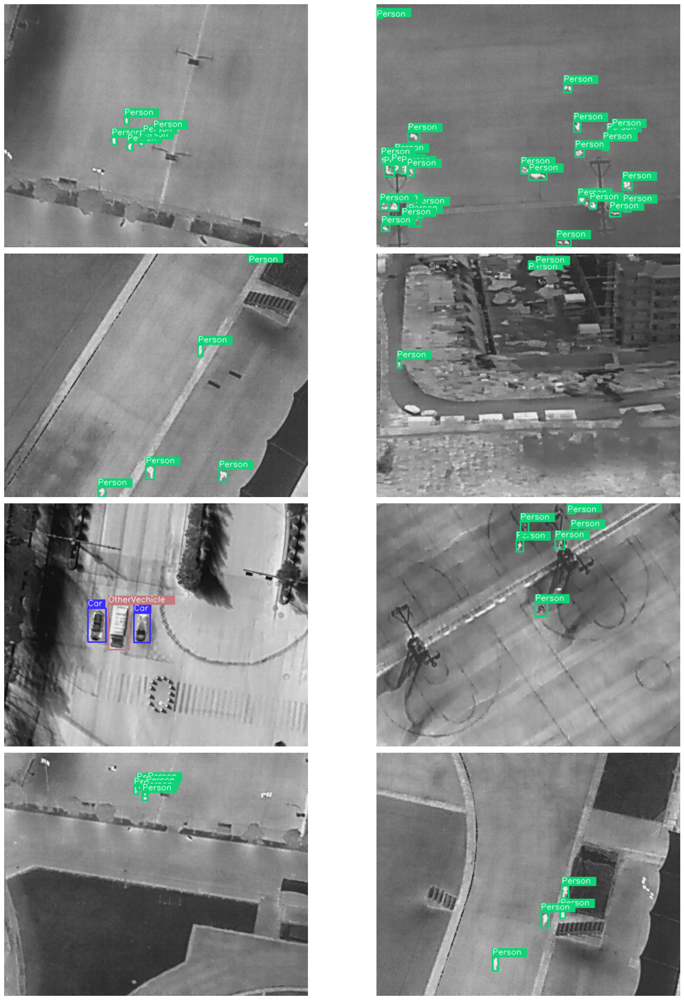

In [36]:
# Visualize a few training images.
plot(
    image_path=os.path.join(ROOT_DIR, train_imgs_dir), 
    label_path=os.path.join(ROOT_DIR, train_labels_dir),
    num_samples=8
)

# Prepare dataset

In [37]:
%%writefile dataset.yaml

path: /kaggle/input/hituav-a-highaltitude-infrared-thermal-dataset/hit-uav
train: images/train
val: images/val
test: images/test
names:
  0: Person
  1: Car
  2: Bicycle
  3: OtherVehicle
  4: DontCare
nc: 5

Overwriting dataset.yaml


# Training

## YoloV8m

In [38]:
# Disable wandb
import os
os.environ['WANDB_DISABLED'] = 'true'

In [43]:
from ultralytics import YOLO
# Load a model
# model = YOLO("yolov8s.yaml")  # build a new model from scratch
model = YOLO("yolov8m.pt")  # load a pretrained model (recommended for training)

In [44]:
# Use the model
results = model.train(
   data='dataset.yaml',
   imgsz=512,
   epochs=50,
   batch=16,
   name='yolov8m_v8_50e'
)  # train the model

Ultralytics YOLOv8.0.114 🚀 Python-3.10.10 torch-2.0.0 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=dataset.yaml, epochs=50, patience=50, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8m_v8_50e, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, fraction=1.0, profile=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dyna

AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...
AMP: checks passed ✅
train: Scanning /kaggle/input/hituav-a-highaltitude-infrared-thermal-dataset/hit-uav/labels/train... 2008 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2008/2008 [00:06<00:00, 316.69it/s]
train: WARNING ⚠️ Cache directory /kaggle/input/hituav-a-highaltitude-infrared-thermal-dataset/hit-uav/labels is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))
val: Scanning /kaggle/input/hituav-a-highaltitude-infrared-thermal-dataset/hit-uav/labels/val... 287 images, 0 backgrounds, 0 corrupt: 100%|██████████| 287/287 [00:00<00:00, 297.11it/s]
val: WARNING ⚠️ Cache directory /kaggle/input/hituav-a-highaltitude-infrared-thermal-dataset/hit-uav/labels is not writeable, cache not saved.
Plotting labels to runs/detect/yolov8m_v8_50e/labels.jpg... 
optimizer: AdamW(lr=0

## Visualize performance

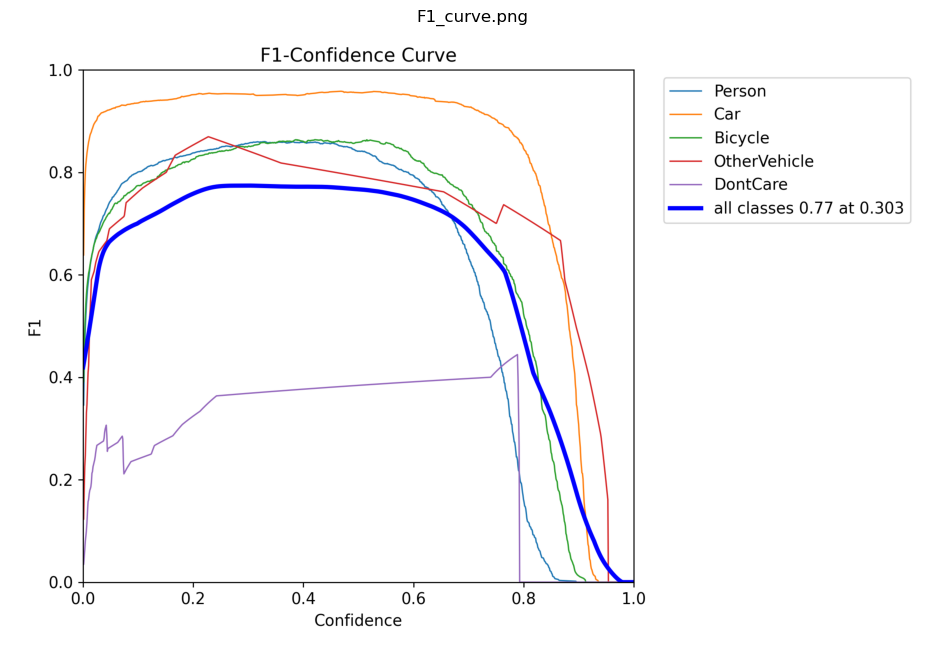

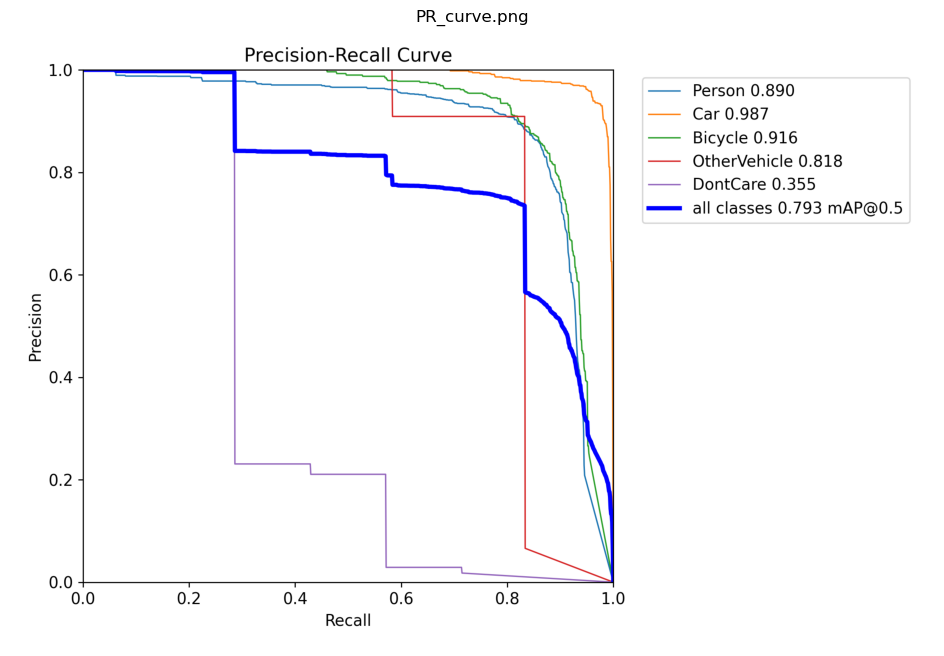

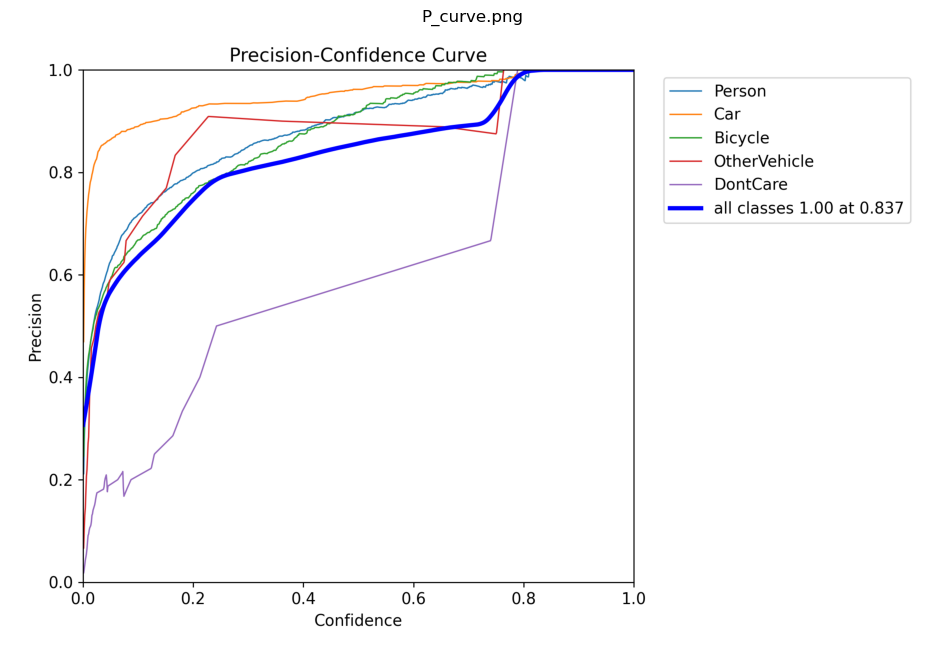

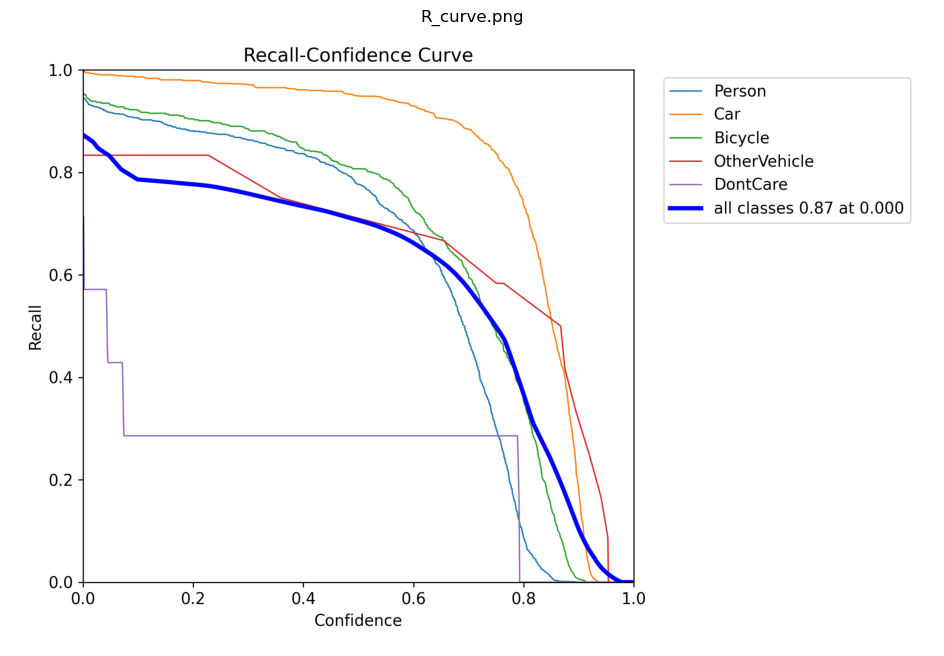

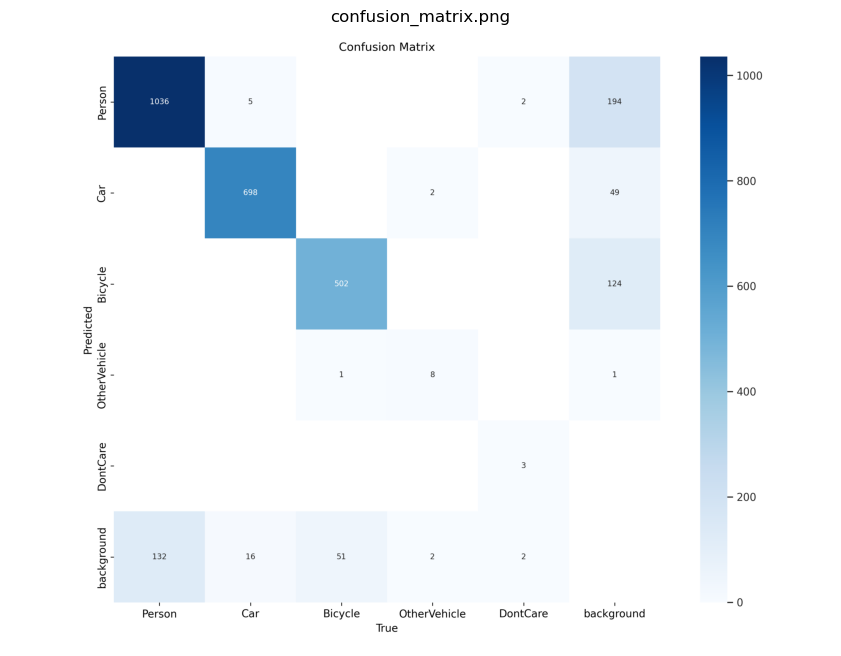

...

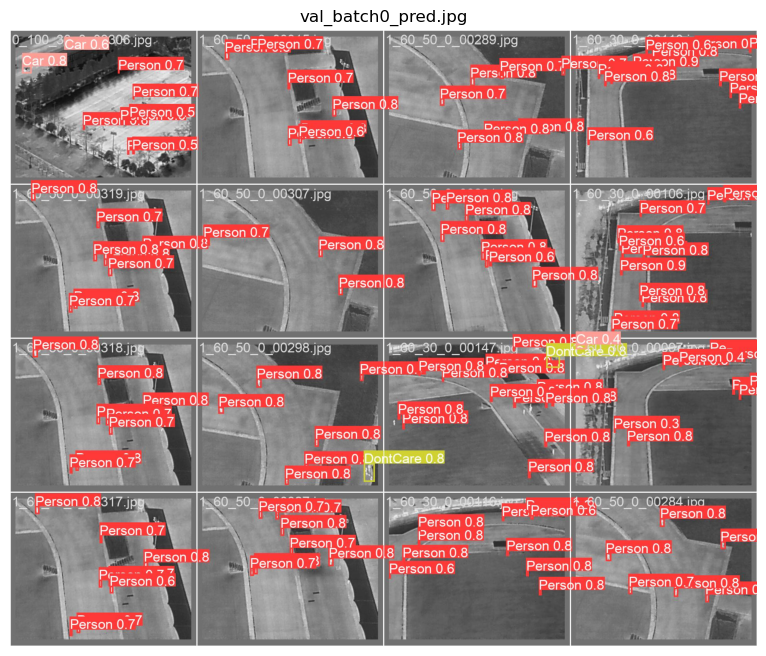

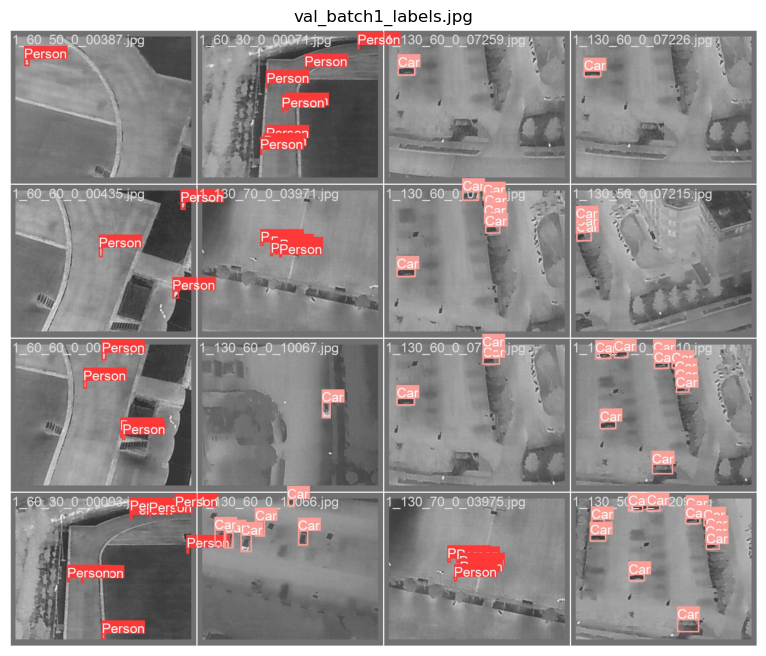

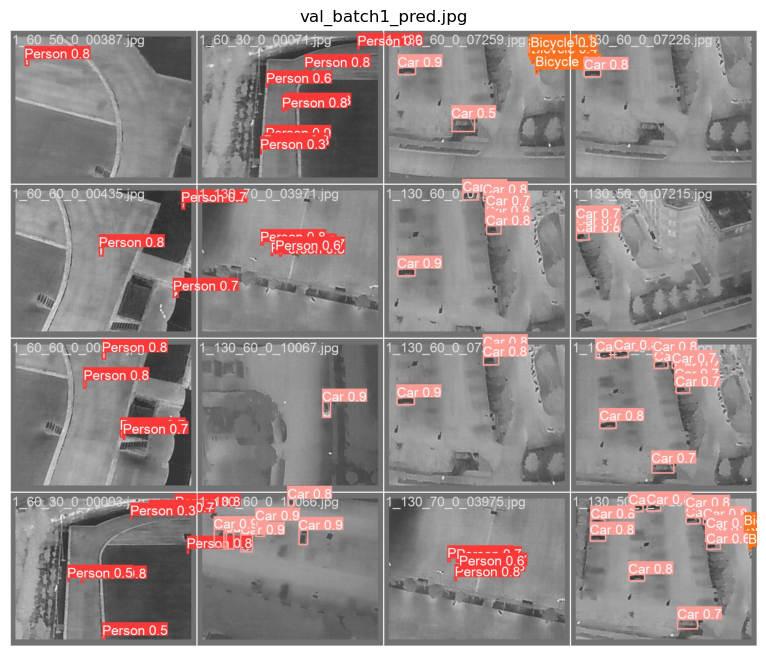

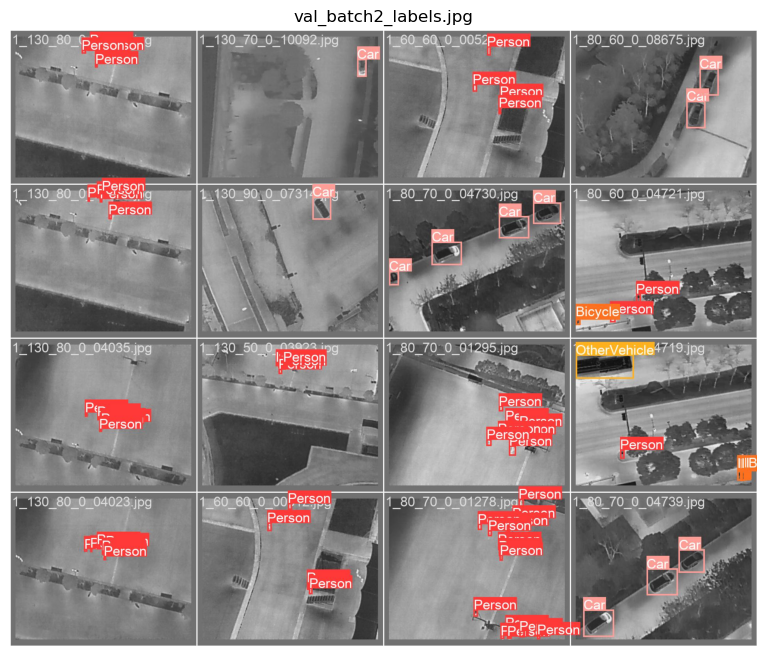

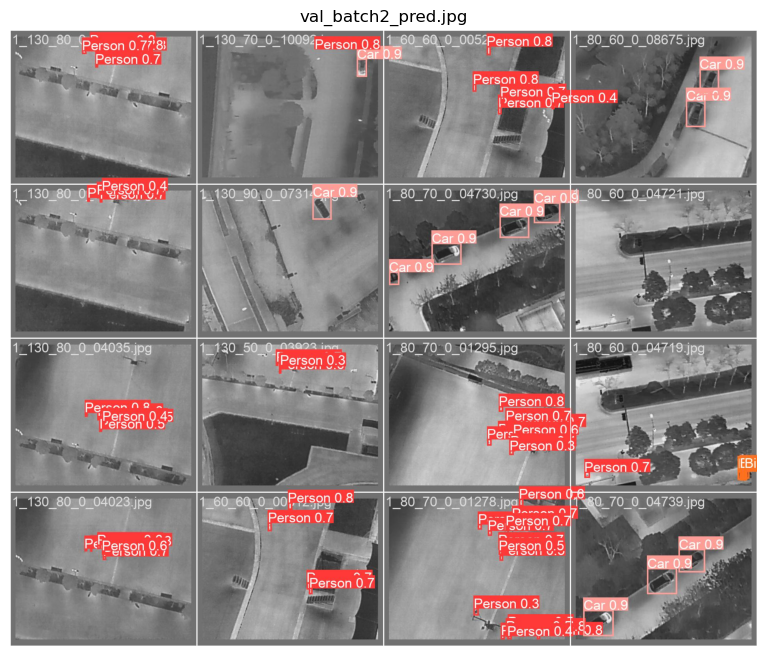

In [47]:
from imutils import paths

log_dir = "runs/detect/yolov8m_v8_50e"
for image_path in sorted(paths.list_images(log_dir)):
    image = Image.open(image_path)
    plt.figure(figsize=(12, 8))
    plt.imshow(image)
    plt.title(os.path.basename(image_path))
    plt.axis('off')
    plt.show()

## Inference on Test Images

In [ ]:
results = model(os.path.join(ROOT_DIR, test_imgs_dir), conf=0.5, agnostic_nms=True, iou=0.5, save=True)

In [ ]:
# results = model(
#     os.path.join(ROOT_DIR, test_imgs_dir, "0_100_30_0_03307.jpg"),
#     conf=0.5, agnostic_nms=True, iou=0.5
# )  # predict on an image
# res_plotted = results[0].plot()
# plt.imshow(res_plotted)
# plt.show()

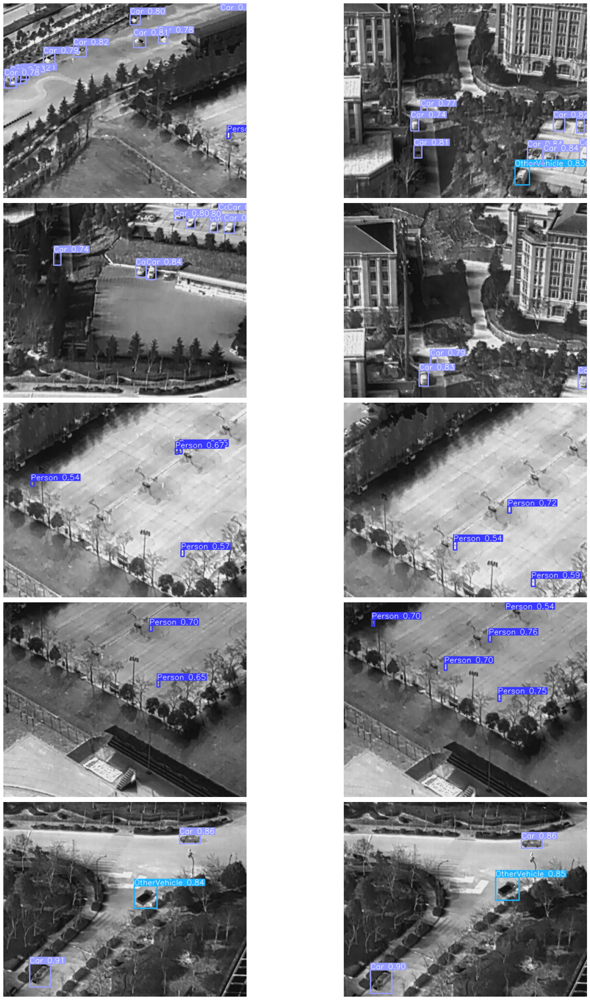

In [49]:
indices = list(range(len(results)))
random_indices = random.sample(indices, 10)
num_cols = 2
num_rows = 5

plt.figure(figsize=(12 * num_cols, 6 * num_rows))
    
for i, idx in enumerate(random_indices):
    image = results[i].plot()
    plt.subplot(num_rows, num_cols, i+1)
    plt.imshow(image)
    plt.axis('off')
plt.tight_layout()
plt.show()

## Compare predictions with ground truth

The ground truth labels will be shown in red box

In [53]:
ground_colors = [(255, 0, 0) for _ in range(len(classes))]

In [51]:
!ls runs/detect

yolov8m_v8_50e	yolov8m_v8_50e2


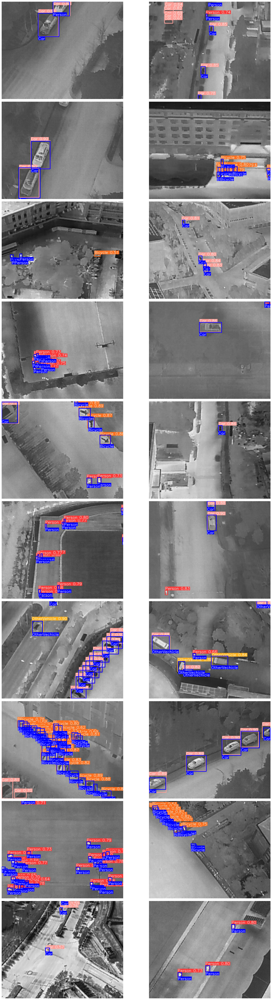

In [54]:
# Comparing a few testing images.
plot(
    image_path='runs/detect/yolov8m_v8_50e2', 
    label_path=os.path.join(ROOT_DIR, test_labels_dir),
    num_samples=20,
    classes=classes,
    colors=ground_colors,
    pos='below'
)

## Export model

In [55]:
success = model.export(format="onnx")  # export the model to ONNX format
success

Ultralytics YOLOv8.0.114 🚀 Python-3.10.10 torch-2.0.0 CPU

PyTorch: starting from runs/detect/yolov8m_v8_50e/weights/best.pt with input shape (16, 3, 512, 512) BCHW and output shape(s) (16, 9, 5376) (49.6 MB)

ONNX: starting export with onnx 1.14.0 opset 17...


================ Diagnostic Run torch.onnx.export version 2.0.0 ================
verbose: False, log level: Level.ERROR
======================= 0 NONE 0 NOTE 0 WARNING 0 ERROR ========================



ONNX: export success ✅ 13.1s, saved as runs/detect/yolov8m_v8_50e/weights/best.onnx (98.7 MB)

Export complete (36.8s)
Results saved to /kaggle/working/runs/detect/yolov8m_v8_50e/weights
Predict:         yolo predict task=detect model=runs/detect/yolov8m_v8_50e/weights/best.onnx imgsz=512 
Validate:        yolo val task=detect model=runs/detect/yolov8m_v8_50e/weights/best.onnx imgsz=512 data=dataset.yaml 
Visualize:       https://netron.app


'runs/detect/yolov8m_v8_50e/weights/best.onnx'